# Finetuning with Wikipedia Data and Evaluating on the Class Dataset

This assignment will build on assignments 4 and 6 by incorporating Wikipedia data and the custom dataset that we built together. In this assignment, we will perform the following tasks:

 * Examine & Evaluate the Wikipedia dataset
 * Clean up the Wikipedia dataset
 * Examine & Evaluate the class dataset
 * Clean up the class dataset
 * Run the model from Assignment 6 on the class dataset
 * Finetune BERT-mini on the Wikipedia dataset
 * Run the Wikipedia finetuned model on the class dataset
 * Summarize your findings

## Examing & Evaluate the Wikipedia Dataset

In week 11, lecture 21 I gave an overview of how I preprocessed Wikipedia and generated Q/A pairs using [Llama-3.1-70b](https://huggingface.co/meta-llama/Llama-3.1-70B-Instruct). This resulted in 42,233 Question/Answer pairs which I have uploaded to Canvas here: [wikipedia-question-answer-pairs.jsonl.zip](https://canvas.colorado.edu/files/77341844/download?download_frd=1).  

### Examine the Wikipedia Dataset
The goal of this portion of the assignment is familiarize yourself with the Wikipedia dataset by characterizing it empirically/quantitatively and anecdotally/qualitatively.  
Please download, unzip, and load the Wikipedia dataset and examine it.  **Run the summary stats** that we ran for the SQuAD dataset in Assignment 4 and **compare and contrast these two datasets**.  Again, please include all code used for this assignment in this notebook even if you are copying code from a previous assignment.  Finally, please scan through the data and highlight a few examples that may be interesting, problematic, or somehow notable in some way.  Being familiar with the data can help you anticipate potential problems, challenges, or opportunities.  Based on looking through the data, makes some observations, reflections, and/or predictions on the quality, usefulness, and/or fitness of this dataset.

In [1]:
import pandas as pd
import json
from transformers import BertTokenizerFast, BertForQuestionAnswering, Trainer, TrainingArguments
from datasets import load_dataset
import torch
import random
from collections import Counter
import statistics
import numpy as np
import math
import matplotlib.pyplot as plt

C:\Users\annal\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\torchvision\datapoints\__init__.py:12: UserWarning: The torchvision.datapoints and torchvision.transforms.v2 namespaces are still Beta. While we do not expect major breaking changes, some APIs may still change according to user feedback. Please submit any feedback you may have in this issue: https://github.com/pytorch/vision/issues/6753, and you can also check out https://github.com/pytorch/vision/issues/7319 to learn more about the APIs that we suspect might involve future changes. You can silence this warning by calling torchvision.disable_beta_transforms_warning().
  warnings.warn(_BETA_TRANSFORMS_WARNING)
C:\Users\annal\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\torchvision\transforms\v2\__init__.py:54: UserWarning: The torchvision.datapoints and torchvision.transforms.

#### SQuAD Dataset

In [2]:
squad = load_dataset("squad")
train_count = len(squad['train'])
val_count = len(squad['validation'])
print(f"Number of training examples: {train_count}")
print(f"Number of validation examples: {val_count}")
print(f"Total number of examples: {train_count+val_count}")

Number of training examples: 87599
Number of validation examples: 10570
Total number of examples: 98169


In [ ]:
def length_stats(examples, text_fxn, len_fxn):
    """
    Parameters:
    examples (dictionary): e.g. squad['train']
    text_fxn (lambda): is a lambda function that takes an example and produces a text (e.g. a context or an answer) which we can then me
    len_fxn (lambda): is a lambda function that takes a text and returns a count such as the length in character or the number of tokens
    Returns:
    total (int): total count for all lengths of all the texts seen
    maximum (int): maximum length seen
    minimum (int): minimum length seen
    mean (float): average length
    median (float): median length
    mode (int): length that occurs most frequently.
    """
    maximum = -1
    minimum = 99999999
    lengths = []
    for example in examples:
        text = text_fxn(example) # Get the context
        length = len_fxn(text) # Get the context length
        lengths.append(length)
        if length > maximum:
            maximum = length
        if length < minimum:
            minimum = length
    total = sum(lengths)
    np_len = np.array(lengths)
    mean = np.mean(np_len)
    median = np.median(np_len)
    mode = statistics.mode(lengths)
    # the last line of the function should be equivalent to the following:
    return total, maximum, minimum, mean, median, mode

def compute_context_lengths_chars(examples):
    """
    This method should return the total, max, min, average (mean), median, and mode of the context lengths as measured in characters.
    Methods you might find useful are: len
    """
    # this function says "pass in an example and return its context"
    text_fxn = lambda example: example['context']
    # this function says "pass in a context and returns its length"
    len_fxn = lambda context: len(context)
    return length_stats(examples, text_fxn, len_fxn)

def compute_context_lengths_tokens(examples):
    """
    This method should return the total, max, min, average (mean), median, and mode of the context lengths as measured in white-space se
    Methods you might find useful are: len, string.split (for tokenization)
    """
    # this function says "pass in an example and return its context"
    text_fxn = lambda example: example['context']
    # this function says "pass in a context and returns its length"
    len_fxn = lambda context: len(context.split())
    return length_stats(examples, text_fxn, len_fxn)

def compute_answer_lengths_chars(examples, wiki=False):
    """
    This method should return the total, max, min, average (mean), median, and mode of the answer lengths as measured in characters.
    Methods you might find useful are len
    """
    # this function says "pass in an example and return its context"
    # SQuAD indexes by 'answers' and Wiki indexes by 'answer'
    if wiki:
        text_fxn = lambda example: example['answer']
    else:
        text_fxn = lambda example: example['answers']['text'][0]
    # this function says "pass in a context and returns its length"
    len_fxn = lambda context: len(context)
    return length_stats(examples, text_fxn, len_fxn)

def compute_answer_lengths_tokens(examples, wiki=False):
    """
    This method should return the total, max, min, average (mean), median, and mode of the answer lengths as measured in characters.
    Methods you might find useful are len
    """
    # this function says "pass in an example and return its context"
    # SQuAD indexes by 'answers' and Wiki indexes by 'answer'
    if wiki: 
        text_fxn = lambda example: example['answer']
    else: 
        text_fxn = lambda example: example['answers']['text'][0]
    # this function says "pass in a context and returns its length"
    len_fxn = lambda context: len(context.split())
    return length_stats(examples, text_fxn, len_fxn)

def compute_question_lengths_tokens(examples):
    """
    This method should return the total, max, min, average (mean), median, and mode of the context lengths as measured in white-space se
    Methods you might find useful are: len, string.split (for tokenization)
    """
    # this function says "pass in an example and return its context"
    text_fxn = lambda example: example['question']
    # this function says "pass in a context and returns its length"
    len_fxn = lambda context: len(context.split())
    return length_stats(examples, text_fxn, len_fxn)

In [4]:
print("Training Data")
print(f'Format: (total, maximum, minimum, mean, median, mode)')
print('Context by Chars: ', compute_context_lengths_chars(squad['train']))
print('Context by Token: ', compute_context_lengths_tokens(squad['train']))
print('Answer by Chars: ', compute_answer_lengths_chars(squad['train']))
print('Answer by Token: ', compute_answer_lengths_tokens(squad['train']))

print("\n\nValidation Data")
print(f'Format: (total, maximum, minimum, mean, median, mode)')
print('Context by Chars: ', compute_context_lengths_chars(squad['validation']))
print('Context by Token: ', compute_context_lengths_tokens(squad['validation']))
print('Answer by Chars: ', compute_answer_lengths_chars(squad['validation']))
print('Answer by Token: ', compute_answer_lengths_tokens(squad['validation']))

Training Data
Format: (total, maximum, minimum, mean, median, mode)
Context by Chars:  (66081551, 3706, 151, 754.3642164864896, 693.0, 597)
Context by Token:  (10491130, 653, 20, 119.76312514983047, 110.0, 87)
Answer by Chars:  (1764881, 239, 1, 20.147273370700578, 14.0, 4)
Answer by Token:  (277002, 43, 1, 3.162159385381112, 2.0, 1)


Validation Data
Format: (total, maximum, minimum, mean, median, mode)
Context by Chars:  (8233854, 4063, 157, 778.9833491012299, 703.0, 631)
Context by Token:  (1310201, 629, 22, 123.9546830652791, 112.0, 104)
Answer by Chars:  (204878, 160, 1, 19.382970671712393, 14.0, 4)
Answer by Token:  (31884, 29, 1, 3.016461684011353, 2.0, 1)


#### Wikipedia Dataset

In [5]:
# Load in the data as a list
with open('wikipedia-question-answer-pairs.jsonl', 'r') as f:
    wiki_data = [json.loads(line) for line in f]

for example in wiki_data:
    example['answer'] = example['answer'].split(',')
    
print(wiki_data)

[{'id': 'COVID-19 pandemic in Tamil Nadu.19', 'title': 'COVID-19 pandemic in Tamil Nadu', 'context': ' The state government was among the first to launch measures against COVID-19. On 30 January, it had put 78 people who arrived from China under quarantine. The state government had announced a relief package on 24 March. It included financial support of to all ration card holders, free rice and other essential commodities in the wake of lockdown. It also provided registered street vendors, autorickshaw drivers, migrant labourers and construction workers in the state with similar provisions. It had also announced extension periods of three months to make loan and tax payments for all citizens, and one month to pay house rent for workers including migrants across the state. Currently, the government operates 311 relief camps and shelters for migrant workers.Earlier, it had allocated sum of from disaster relief fund to deal with the crisis. It had also taken steps to provide medicines for

In [6]:
# Read in the wiki dataset (in the cell above, it was read in as a list)
wiki_dataset = load_dataset("json", data_files="wikipedia-question-answer-pairs.jsonl")
print(wiki_dataset)
print("Number of Training Examples: ", len(wiki_dataset['train']))

DatasetDict({
    train: Dataset({
        features: ['id', 'title', 'context', 'question', 'answer', 'answer_sentence'],
        num_rows: 42233
    })
})
Number of Training Examples:  42233


In [7]:
def print_example(index, example):
    print(f"example[{index}]: id = {example['id']}")
    print(f"title = {example['title']}")
    print(f"context = {example['context']}")
    print(f"question = {example['question']}")
    print(f"answer = {example['answer']}")

In [8]:
# Following the steps from here: https://www.statisticshowto.com/probability-and-statistics/variance/
# Returns the variance of the context and answer based on number of tokens
def variance(examples, mean_c, mean_q, mean_a, wiki=True):
    xu_c = []
    xu_q = []
    xu_a = []
    c = []
    q = []
    a = []
    for example in examples:
        # Get the right text segment
        context = example['context']
        question = example['question']
        if wiki:
            answer = example['answer']
        else:
            # Use only the first answer, if there are multiple
            answer = example['answers']['text'][0]

        # Get the lengths of each segment, then add it to a list for plotting
        len_context = len(context.split())
        len_question = len(question.split())
        len_ans = len(answer.split())
        c.append(len_context)
        q.append(len_question)
        a.append(len_ans)

        # Calculate the variance
        xu_c.append(len_context - mean_c)
        xu_q.append(len_question - mean_q)
        xu_a.append(len_ans - mean_a)
    xuc_squared = [i ** 2 for i in xu_c]
    xuq_squared = [i ** 2 for i in xu_q]
    xua_squared = [i ** 2 for i in xu_a]

    c_sum = sum(xuc_squared) / len(xuc_squared)
    q_sum = sum(xuq_squared) / len(xuq_squared)
    a_sum = sum(xua_squared) / len(xua_squared)

    return c_sum, q_sum, a_sum, c, q, a

# Calculate a standard deviation
def std(var):
    return math.sqrt(var)

# Calculate the variance/standard deviation for the lengths of contexts/questions/answers by token
c_mean = compute_context_lengths_tokens(wiki_dataset['train'])[3]
q_mean = compute_question_lengths_tokens(wiki_dataset['train'])[3]
a_mean = compute_answer_lengths_tokens(wiki_dataset['train'], wiki=True)[3]
c_var, q_var, a_var, c, q, a = variance(wiki_dataset['train'], c_mean, q_mean, a_mean)
c_std = std(c_var)
q_std = std(q_var)
a_std = std(a_var)
print("Context Variance: ", c_var)
print("Question Variance: ", q_var)
print("Answer Variance: ", a_var)
print("Context Standard Deviation: ", c_std)
print("Question Standard Deviation: ", q_std)
print("Answer Standard Deviation: ", a_std)

Context Variance:  16863.475982547814
Question Variance:  14.668949185912089
Answer Variance:  6.448188337953808
Context Standard Deviation:  129.85944702850006
Question Standard Deviation:  3.8300064211319658
Answer Standard Deviation:  2.53932832417429


In [9]:
# The Wikipedia data is not split into test/validation sets
print("Total Number of Examples: ", len(wiki_dataset['train']))
print("\n\nWikipedia Data")
print(f'Format: (total, maximum, minimum, mean, median, mode)')
print('Context by Chars: ', compute_context_lengths_chars(wiki_dataset['train']))
print('Context by Token: ', compute_context_lengths_tokens(wiki_dataset['train']))
print('Answer by Chars: ', compute_answer_lengths_chars(wiki_dataset['train'], wiki=True))
print('Answer by Token: ', compute_answer_lengths_tokens(wiki_dataset['train'], wiki=True))

Total Number of Examples:  42233


Wikipedia Data
Format: (total, maximum, minimum, mean, median, mode)
Context by Chars:  (25559123, 7823, 20, 605.1931664811877, 317.0, 30)
Context by Token:  (4057750, 1336, 1, 96.08007955863899, 50.0, 5)
Answer by Chars:  (612583, 856, 0, 14.504842185021191, 11.0, 4)
Answer by Token:  (99698, 131, 0, 2.360665830038122, 2.0, 1)


### Evaluate the Wikipedia Dataset 
The goal of this portion of the assignment is to evaluate how good the Wikipedia dataset is by sampling some number of examples from the dataset and evaluate how good they are.  Roughly speaking, what we would like to know is how many of these question/answer pairs are of high quality and how many are poor quality.  You should randomly sample from the dataset and evaluate how good the examples are.  Questions you might ask include: Is the context sufficiently interesting/appropriate for use to generate a Question/Answer pair? Is the question appropriate given the context?  Is the answer correct given the question?  Is the answer a substring of the context as required?  Is the example good/bad/neutral?  

This section is rather open ended and there are many ways you can tackle this challenge.  If you want to employ a LLM service such as OpenAI ChatGPT, Bing Copilot, or others to help with your analysis (i.e. using an API token), then that would be great!  You can write scripts to answer questions that you think are relevant (e.g. are the answers proper substrings of the context?)  You can do all of the analysis manually.

How many examples should you sample?  This depends on what kind of analysis you are doing. If you are doing purely manual inspection of the data, then perhaps a couple of dozen makes sense.  If you are using an API token, then perhaps a few hundred or a few thousand makes sense.  If you can automatically answer a question with a simple script, then run it on all of the examples.

What is the end result here?  Please report any results you have gathered from your analysis and share any observations about what you learned.  Speculate on what additional analysis you might do if you had more time, resources, or people helping you.  Project your findings to the entire dataset to make educated guesses about how we might characterize the quality of this dataset (is it amazing?!  Is it terrible?!  Is it likely to be useful?)

In [10]:
# Choose a random one from the dataset to examine. Particularly interesting examples follow in the cell below
index = random.randint(0, len(wiki_dataset['train']) - 1)
print_example(index, wiki_dataset['train'][index])

example[18353]: id = Hopea dryobalanoides.2
title = Hopea dryobalanoides
context =  Hopea dryobalanoides is native to Peninsular Malaysia, Sumatra and Borneo. Its habitat is mixed dipterocarp forest, to elevations of . 
question = What are the elevations to which Hopea dryobalanoides is typically found?
answer = 0


In [11]:
# In this example, the capitalization is different, but the answer is a substring of the context
print_example(index, wiki_dataset['train'][19213])

example[18353]: id = Electoral registration officer.2
title = Electoral registration officer
context =  In Northern Ireland, the Electoral Office for Northern Ireland (led by the Chief Electoral Officer for Northern Ireland) is responsible for electoral registration. 
question = Who is responsible for electoral registration in Northern Ireland?
answer = The Electoral Office for Northern Ireland


In [12]:
# Here, the answer is not found in the context, so we should toss the example
print_example(index, wiki_dataset['train'][41198])

example[18353]: id = Yuanzhao Temple.4
title = Yuanzhao Temple
context =  The Maitreya Buddha and Four Heavenly Kings' statues are enshrined in the Hall of Four Heavenly Kings. They are the eastern Dhṛtarāṣṭra, the southern Virūḍhaka, the western Virūpākṣa, and the northern Vaiśravaṇa. Inside the hall, two plaques with Chinese couplet are hung on the two side pillars. It says "". The hall has a width of and a depth of . Under the eaves is a plaque written by Qianlong Emperor (1735-1796) in the Qing dynasty (1644-1911). 
question = What is the width of the Hall of Four Heavenly Kings?
answer = 8.85


In [13]:
# This context is in Indonesian, but the answer is in English
print_example(index, wiki_dataset['train'][41204])

example[18353]: id = Draft:We Make it ON.0
title = Draft:We Make it ON
context =  We Make It ONSemboyan yang digunakan oleh para petugas di sub-direktorat Teknik di Terminal Teluk Lamong. Tugas pokok dari para petugas adalah memastikan bahwa semua fasilitas dan peralatan pelabuhan berfungsi atau ON sepanjang waktu pelayanan terminal. 
question = What is the main task of the officers in the sub-directorate of Engineering at the Teluk Lamong Terminal?
answer = to ensure that all port facilities and equipment are functioning or ON during terminal service hours


In [14]:
# This page is a disambuguation page: https://en.wikipedia.org/wiki/Wikipedia:Disambiguation
print_example(index, wiki_dataset['train'][41224])

example[18353]: id = Melissus.1
title = Melissus
context =  * Melissaeus (disambiguation) 
question = What does Melissaeus refer to?
answer = disambiguation


In [15]:
# I'm also not sure where this answer is coming from, since it is not found in the context
print_example(index, wiki_dataset['train'][23700])

example[18353]: id = Tzofit.0
title = Tzofit
context =  Tzofit () is a moshav in central Israel. Located near Kfar Saba, it falls under the jurisdiction of Drom HaSharon Regional Council. In it had a population of . 
question = What is the population of Tzofit?
answer = 1,500


In [ ]:
# Copied from my submission of Assignment 6
def evaluate_dataset(examples, wiki=False):
    bad_answer_count = 0
    good_answer_count = 0
    good_id = []
    for i, example in enumerate(examples):
        # Get the answer and context from the example
        if wiki:
            answer = example['answer']
        else:
            answer = example['answers']['text'][0]
        context = example['context']
        context_len_token = context.split() # Tokenize the context

        # Ensure the answer is a substring of the context
        # Ensure the context has more than three words
        # Ensure the page is not a disambiguation page
        if answer in context and len(context_len_token) >= 3 and '(disambiguation)' not in context:
            good_answer_count += 1
            good_id.append(i)
        else:
            bad_answer_count += 1
        
    print(f"bad_answer_count = {bad_answer_count}")
    print(f"good_answer_count = {good_answer_count}")
    return good_id

In [17]:
# Get a list of the IDs we want to keep in the dataset
print("Wikipedia Evaluation:")
good_id = evaluate_dataset(wiki_dataset['train'], wiki=True)
print(good_id)

Wikipedia Evaluation:
bad_answer_count = 2773
good_answer_count = 39460
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 56, 57, 58, 59, 60, 61, 62, 63, 64, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 126, 127, 128, 129, 130, 132, 133, 134, 135, 136, 137, 138, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 194, 195, 196, 197, 198, 199, 200, 202, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220,

#### Discussion

I evaluate the examples based on the following criteria:

- The answer must be a substring of the context
- The context must have more than three words

Any example that does not meet these criteria is a "bad answer", and I will remove these in the following section.

If I had more time, I would use an LLM to help me evaluate the answers. I would give it the context/question/answer, and ask it to return either "good" or "bad" based on whether the answer is correct (given the context), whether there is enough context to sufficiently answer the question, and whether the question makes sense for the context. If any three of these criteria fails, the LLM should return "bad" so that I can toss it from the dataset.

## Clean up the Wikipedia dataset

Based on what you have learned so far from the previous two exercises, how would you improve this dataset?  Please clean up this dataset by performing the following:
 * removing examples where the answer is not a substring of the context
 * removing examples where the context, question, or answer lengths fall outside of statistical norms.
 * Did you find anything problematic about the examples that you looked at that could easily be identified for removal?

Please summarize the results of this effort - i.e. please indicate how many examples you removed and for what reasons.  Please also speculate on how you might further clean up this data if you had more time.

In [18]:
# TODO - supporting code and results should go here
# Create a new, smaller dataset where all the entries passed the evaluation function
wiki_clean_temp = wiki_dataset['train'].select(good_id)
print(wiki_clean_temp)

Dataset({
    features: ['id', 'title', 'context', 'question', 'answer', 'answer_sentence'],
    num_rows: 39460
})


Text(0.5, 1.0, 'Answer Lengths')

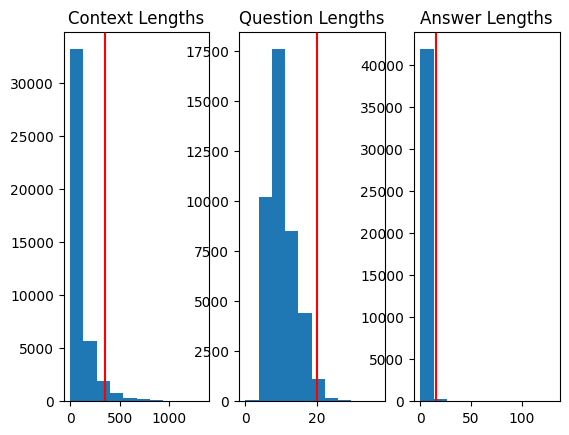

In [19]:
# Plot the lengths of the contexts, questions, and answers
# The red lines are the cutoffs for lengths "outside of statistical norms"
fig, (ax0, ax1, ax2) = plt.subplots(1, 3)
ax0.hist(c)
ax0.axvline(x=c_mean + (c_std * 2), color='r')
ax0.set_title("Context Lengths")
ax1.hist(q)
ax1.axvline(x=q_mean + (q_std * 2.5), color='r')
ax1.set_title("Question Lengths")
ax2.hist(a)
ax2.axvline(x=a_mean + (a_std * 5), color='r')
ax2.set_title("Answer Lengths")

In [20]:
# Modified based on the original evaluate function
def evaluate_length(examples, wiki=False):
    bad_answer_count = 0
    good_answer_count = 0
    good_id = []
    for i, example in enumerate(examples):
        if wiki:
            if len(example['context'].split()) < (c_mean + (c_std * 2)) and len(example['question'].split()) < (q_mean + (q_std * 2.5)) and len(example['answer'].split()) < (a_mean + (a_std * 5)):
                good_answer_count += 1
                good_id.append(i)
            else:
                bad_answer_count += 1
        else:
            if len(example['context'].split()) < (c_mean + (c_std * 2)) and len(example['question'].split()) < (q_mean + (q_std * 2.5)) and len(example['answers']['text'][0].split()) < (a_mean + (a_std * 5)):
                good_answer_count += 1
                good_id.append(i)
            else:
                bad_answer_count += 1
    print(f"bad_answer_count = {bad_answer_count}")
    print(f"good_answer_count = {good_answer_count}")
    return good_id

good_id_len = evaluate_length(wiki_clean_temp, wiki=True)
print("Good IDs based on length: ", good_id_len)
wiki_clean = wiki_clean_temp.select(good_id_len)
print(wiki_clean)

bad_answer_count = 2694
good_answer_count = 36766
Good IDs based on length:  [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 35, 36, 37, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 108, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 139, 140, 141, 142, 143, 144, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 180, 181, 182, 183, 184, 185, 186, 187, 188, 190, 191, 192, 193, 194, 196, 197, 198, 199, 200, 201, 202, 203, 204, 206, 207, 208, 209, 210, 211, 213, 215, 216, 217, 218, 219, 220, 221, 

#### Discussion

In total, I removed 5467 rows. 2773 examples did not pass the evaluation function. Of these, there were 2549 where the context was not a substring of the answer or the context was under three words (which is too short to be helpful). There were 224 disambiguation pages, which I removed because they do not include information useful for question-answering. 2696 examples fell outside statistical norms in regards to the length of context, question, or answer. To determine the cutoff values, I plotted a histogram of lengths, then chose the cutoff visually.

If I had more time, I try to fix the poorly-formatted examples. For example, 41225 ("id": "Ambling gait.1") is not puntuated correctly - since this was quite difficult to automatically detect, I left it in the dataset. I would also like to try this evaluation/finetuning method if the punctuation were entirely removed. This would help BERT to focus on the content rather than the formatting.

## Examine & Evaluate the class dataset 

In assignment 4, everyone created 10 question / answer pairs.  These have been aggregated into a single file which can be downloaded here: [class_dataset.jsonl.zip](https://canvas.colorado.edu/files/77342044/download?download_frd=1).  The resulting dataset has 572 examples.  This is going to be our evaluation dataset for the rest of this assignment.  Let's do the same analysis for this dataset as we did for the Wikipedia dataset.

### Examine the class dataset 

Please perform the same exploratory analysis on this dataset as you did for the Wikipedia dataset and compare and contrast this dataset with both the SQuAD data and the Wikipedia data.  

In [ ]:
# Load in the data
with open('class_dataset.jsonl', 'r') as f:
    class_data = [json.loads(line) for line in f]

print(class_data)

[{'context': 'Marie Curie, a Polish-French physicist and chemist, was the first woman to receive a Nobel Prize and the only woman to receive two Nobel prizes. While studying uranium’s rays, she discovered new elements and named them polonium and radium. ', 'question': 'Who was the first women to win a Nobel Prize?', 'source': 'https://awis.org/historical-women/marie-curie/#:~:text=Marie%20Sk%C5%82odowska%2DCurie%2C%20a%20Polish,named%20them%20polonium%20and%20radium.', 'answers': {'text': ['Marie Curie'], 'answer_start': [0]}}, {'context': 'China produces the largest amount of wheat at 808 million metric tonnes.', 'question': 'Which country produces the largest amount of wheat?', 'source': 'https://en.wikipedia.org/wiki/List_of_countries_by_wheat_production', 'answers': {'text': ['China'], 'answer_start': [0]}}, {'context': 'The Bay of Pigs is a bay on the south coast of Cuba, and it was the site of a failed US-backed invasion in 1961.', 'question': 'In which country did the Bay of Pig

In [ ]:
class_dataset = load_dataset("json", data_files="class_dataset.jsonl")
print(class_dataset)

DatasetDict({
    train: Dataset({
        features: ['context', 'question', 'source', 'answers'],
        num_rows: 572
    })
})


In [ ]:
# no need to duplicate code that is already provided above.  Please refactor the above code as resuable functions as appropriate so you do not repeat large amounts of code here.
# The Wikipedia data is not split into test/validation sets
print("Total Number of Examples: ", len(class_dataset['train']))
print("\n\nClass Data")
print(f'Format: (total, maximum, minimum, mean, median, mode)')
print('Context by Chars: ', compute_context_lengths_chars(class_dataset['train']))
print('Context by Token: ', compute_context_lengths_tokens(class_dataset['train']))
print('Answer by Chars: ', compute_answer_lengths_chars(class_dataset['train']))
print('Answer by Token: ', compute_answer_lengths_tokens(class_dataset['train']))

Total Number of Examples:  572


Class Data
Format: (total, maximum, minimum, mean, median, mode)
Context by Chars:  (258669, 4243, 25, 452.21853146853147, 300.5, 1146)
Context by Token:  (42065, 564, 5, 73.54020979020979, 49.0, 22)
Answer by Chars:  (15646, 430, 1, 27.353146853146853, 14.0, 4)
Answer by Token:  (2475, 86, 1, 4.326923076923077, 2.0, 1)


### Evaluate the class Dataset - 5 points (of 10)
Please perform the same evaluation analysis on the class dataset as you did for the Wikipedia dataset and compare and contrast what you found here with what you found when looking at the Wikipedia data.  

In [24]:
# First, I will look at some examples of data to see what patterns there are
# This is a yes/no question, so the answer does not really fit the question. Additionally, it is really subjective (which is hard to algorithmically capture)
print(class_dataset['train'][554])

{'context': 'The development of artificial intelligence has made significant contributions to the financial sector.', 'question': 'Does AI make a contribution to finance?', 'source': 'https://arxiv.org/abs/2411.04259', 'answers': {'text': ['artificial intelligence has made significant contributions to the financial sector'], 'answer_start': [19]}}


In [25]:
# TODO - supporting code and results should go here
# no need to duplicate code that is already provided above.  Please refactor the above code as resuable functions as appropriate so you do not repeat large amounts of code here.
print("Class Dataset Evaluation:")
good_class_ids = evaluate_dataset(class_dataset['train'])
print(good_class_ids)

Class Dataset Evaluation:
bad_answer_count = 0
good_answer_count = 572
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207

In [26]:
# Calculate the variance/standard deviation for the lengths of contexts/questions/answers by token
class_c_mean = compute_context_lengths_tokens(class_dataset['train'])[3]
class_q_mean = compute_question_lengths_tokens(class_dataset['train'])[3]
class_a_mean = compute_answer_lengths_tokens(class_dataset['train'])[3]
class_c_var, class_q_var, class_a_var, class_c, class_q, class_a = variance(class_dataset['train'], c_mean, q_mean, a_mean, wiki=False)
class_c_std = std(class_c_var)
class_q_std = std(class_q_var)
class_a_std = std(class_a_var)
print("Context Variance: ", class_c_var)
print("Question Variance: ", class_q_var)
print("Answer Variance: ", class_a_var)
print("Context Standard Deviation: ", class_c_std)
print("Question Standard Deviation: ", class_q_std)
print("Answer Standard Deviation: ", class_a_std)

Context Variance:  5000.2171892736
Question Variance:  13.822260543196915
Answer Variance:  50.97082732424122
Context Standard Deviation:  70.71221386205922
Question Standard Deviation:  3.7178300853047217
Answer Standard Deviation:  7.13938564053247


In [27]:
plt.close()

Text(0.5, 1.0, 'Answer Lengths')

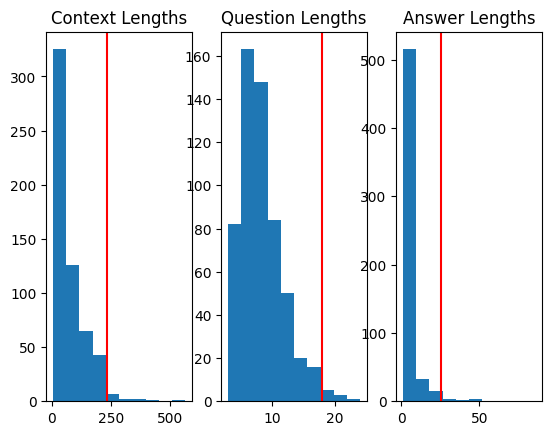

In [28]:
# Plot the lengths of the contexts, questions, and answers
# The red lines are the cutoffs for lengths "outside of statistical norms"
fig, (ax0, ax1, ax2) = plt.subplots(1, 3)
ax0.hist(class_c)
ax0.axvline(x=class_c_mean + (class_c_std * 2.25), color='r')
ax0.set_title("Context Lengths")
ax1.hist(class_q)
ax1.axvline(x=class_q_mean + (class_q_std * 2.5), color='r')
ax1.set_title("Question Lengths")
ax2.hist(class_a)
ax2.axvline(x=class_a_mean + (class_a_std * 3), color='r')
ax2.set_title("Answer Lengths")

## Clean up the class dataset - 10 points
Please perform the same cleanup work on the class dataset as you did with the Wikipedia dataset and report how many examples you removed and for what reasons.

In [ ]:
# Create a new, smaller dataset where all the entries passed the evaluation function
class_clean_temp = class_dataset['train'].select(good_class_ids)
print(class_clean_temp)

Dataset({
    features: ['context', 'question', 'source', 'answers'],
    num_rows: 572
})


In [30]:
good_id_len = evaluate_length(class_clean_temp, wiki=False)
print("Good IDs based on length: ", good_id_len)
class_clean = class_clean_temp.select(good_id_len)
print(class_clean)

bad_answer_count = 36
good_answer_count = 536
Good IDs based on length:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 114, 116, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 184, 185, 189, 190, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 

## Run the model from Assignment 6 on the class dataset - 10 points

The purpose of this exercise is to run the best model that you trained in Assignment 6 on the class dataset to get baseline results.  Please run the model on this dataset and report the results here.

In [31]:
# TODO - supporting code and results should go here
tokenizer = BertTokenizerFast.from_pretrained('prajjwal1/bert-mini')
model = BertForQuestionAnswering.from_pretrained('results/checkpoint-8214')

In [ ]:
def answer_question_substring(question, context, model, tokenizer):
    """
    This method should return an answer predicted by the model that is a proper substring of the provided context.
    This new implementation will look very much like the implementation of 'answer_question' above except that
    we need to ask the tokenizer to keep track of character offsets and then use those offsets to extract a substring
    of the context variable.

    Use the parameter value setting "return_offsets_mapping=True" when calling the tokenizer.  Then use the resulting
    offsets which you can retrieve with this: "inputs['offset_mapping']".

    Note: My first attempt to implement this threw an error that told me to use BertTokenizerFast so this is why we are using it!
    Note: After I updated the tokenizer, I got the following error:
              BertForQuestionAnswering.forward() got an unexpected keyword argument 'offset_mapping'
          I worked around this error by simply removing 'offset_mapping' from the inputs after assigning it to a local variable and
          before sending inputs to the model.
    Note: This method should not use tokenizer.convert_tokens_to_string
    Note: the logic for using start_index and end_index is a little different here.  You'll have to think carefully about how to get
          the end character index.
    """
    # print("Q: ", question)
    # print("C: ", context)
    inputs = tokenizer(question, context, return_tensors='pt', truncation=True, max_length=512, return_offsets_mapping=True)
    # print(inputs)

    # Save the offset maping to a local variable, then delete it out of the inputs dictionary
    offsets = inputs['offset_mapping']
    del inputs['offset_mapping']
    # print("Offsets: ", offsets)

    input_ids = inputs["input_ids"].tolist()[0]
    token_type_ids = inputs['token_type_ids']
    context_start_index = (token_type_ids == 1).nonzero(as_tuple=True)[1].min().item()
    # print("C Start Index: ", context_start_index)

    with torch.no_grad():
        outputs = model(**inputs)
        start_scores = outputs.start_logits
        end_scores = outputs.end_logits

    # start_scores = start_scores[0:len(start_scores) - 1]
    
    start_index = torch.argmax(start_scores[0][context_start_index:]) + context_start_index

    # print("Trunc End: ", end_scores[0][start_index:-1])
    end_index = torch.argmax(end_scores[0][start_index:]) + start_index

    # print("Start: ", start_index, "End: ", end_index)

    # answer = tokenizer.convert_tokens_to_string(tokenizer.convert_ids_to_tokens(input_ids[start_index:end_index]))
    # print(answer)

    # print(start_index, end_index)
    # print(offsets[0][start_index], offsets[0][end_index])

    # Directly substring the context rather then converting the indexes to strings
    # print(len(offsets[0]))
    # print(len(offsets[0]))
    # print(offsets[0][54])
    # print("Start Index: ", offsets[0][start_index][0])
    # print("End Index: ", offsets[0][end_index][1])
    answer = context[offsets[0][start_index][0]: offsets[0][end_index][1]]
    # print("Ans: ", answer)
    return answer
# answer_question_substring(class_clean[5]['question'], class_clean[5]['context'], model, tokenizer)
# answer_question_substring(class_clean[7]['question'], class_clean[7]['context'], model, tokenizer)

In [33]:
def accept_answer(expected_answer, actual_answer):
    """
    This method should return a boolean that determines whether or not to accept the answer returned by the model
    (actual_answer) given the expected answer provided by the training data (expected_answer). This method should
    account for the factors listed above and can be considered complete when all of the unit tests pass.

    A good strategy for implementing this method is to return True if matching conditions are met and then return
    False at the end of the method.

    Hint: regular expressions will be useful here!

    """
    # print("Expected: ", expected_answer, "Actual: ", actual_answer)
    # Make everything lowercase
    expected_answer = expected_answer.lower()
    actual_answer = actual_answer.lower()

    # Strip the punctuation, keeping only letters and numbers
    expected_answer = "".join(char for char in expected_answer if (char.isalpha() or char.isdigit()))
    actual_answer = "".join(char for char in actual_answer if (char.isalpha() or char.isdigit()))

    # Get the length after punctuation is removed (which seems to pass the test cases)
    len_e = len(expected_answer)
    len_a = len(actual_answer)

    # If the answer is an exact match, it's good!
    if actual_answer == expected_answer:
        return True
    # Otherwise, make sure the actual generated answer contains no more than 50% additional content
    if len_a <= int(len_e * 1.5):
        # Make sure the actual answer contains the expected answer
        if expected_answer in actual_answer:
            return True

    return False

In [34]:
def evaluate(examples, model, tokenizer):

    correct = 0
    progress = 0

    for example in examples:
        question = example['question']
        context = example['context']
        # print("Q: ", question)
        # print("C: ", context)

        actual_answer = answer_question_substring(question, context, model, tokenizer)
        for expected_answer in example['answers']['text']:
            # print("Actual:", actual_answer, "\t Expected: ", expected_answer)
            if accept_answer(expected_answer, actual_answer):
                correct += 1
                print(f"correct answer found: model answer = {actual_answer}, expected_answer = {expected_answer}")
                break
        progress += 1
        if progress % 5000 == 0:
            print(f"progress = {progress}, correct = {correct}")

    return correct


In [35]:
# This was Experiment 2 in Assignment 6, which got 20 correct when validated on SQuAD
model = BertForQuestionAnswering.from_pretrained('results/checkpoint-8214')

In [36]:
evaluate(class_clean, model, tokenizer)

correct answer found: model answer = China, expected_answer = China
correct answer found: model answer = a proud and evil spirit, expected_answer = proud and evil spirit


2

## Finetune BERT-mini on the Wikipedia dataset - 10 points

Please finetune BERT-mini on using the Wikipedia dataset using the approach you used in Assignment 6.  You can either start with a fresh copy of BERT-mini or further finetune the best model you ended up with in Assignment 6.  It may not be reasonable to finetune on all 42K examples from the Wikipedia dataset - and of course you probably shouldn't train on any of the low-quality examples you removed during clean-up.  Do the best you can with the compute that you have!  Please detail the finetuning you did and include information such as how many examples you finetuned with, how many epochs you trained, how long finetuning took, and any other relevant details.  

In [37]:
# Read in the wiki dataset (before, it was read in as a list)
wiki_dataset = load_dataset("json", data_files="wikipedia-question-answer-pairs.jsonl")

In [38]:
# Use 5k out of 42k examples to test the finetuning
wiki_subset = wiki_dataset['train'].select(range(5000))
print(wiki_subset)

Dataset({
    features: ['id', 'title', 'context', 'question', 'answer', 'answer_sentence'],
    num_rows: 5000
})


In [39]:
def preprocess_function(examples):
    questions = [q.strip() for q in examples['question']]
    contexts = [c.strip() for c in examples['context']]
    inputs = tokenizer(questions, contexts, max_length=384, truncation=True, padding='max_length', return_tensors='pt')
    start_positions = []
    end_positions = []
    for i in range(len(examples['answer'])):
        answer = examples['answer'][i]
        start_idx = contexts[i].find(answer)
        end_idx = start_idx + len(answer)
        start_positions.append(start_idx)
        end_positions.append(end_idx)
    inputs.update({'start_positions': start_positions, 'end_positions': end_positions})
    return inputs

tokenized_wiki = wiki_subset.map(preprocess_function, batched=True)

In [40]:
class CustomBertForQuestionAnswering(BertForQuestionAnswering):
    def save_pretrained(self, save_directory, **kwargs):
        # Ensure all tensors are contiguous before saving
        for param in self.parameters():
            if not param.is_contiguous():
                param.data = param.data.contiguous()
        super().save_pretrained(save_directory, **kwargs)
model = CustomBertForQuestionAnswering.from_pretrained('prajjwal1/bert-mini')

C:\Users\annal\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\torch\_utils.py:776: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
Some weights of CustomBertForQuestionAnswering were not initialized from the model checkpoint at prajjwal1/bert-mini and are newly initialized: ['qa_outputs.bias', 'qa_outputs.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


#### Experiment 1

Here, I use 5000 examples from Wikipedia and the following training arguments to get model 939.

In [ ]:
training_args = TrainingArguments(
output_dir='./results',
evaluation_strategy='epoch',
learning_rate=1e-5,
per_device_train_batch_size=16,
num_train_epochs=3,
weight_decay=0.01,
)

C:\Users\annal\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\transformers\training_args.py:1568: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


In [42]:
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=tokenized_wiki,
    eval_dataset=tokenized_wiki,
 )
trainer.train()

  0%|          | 0/939 [00:00<?, ?it/s]

  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 5.522309303283691, 'eval_runtime': 474.3651, 'eval_samples_per_second': 10.54, 'eval_steps_per_second': 1.318, 'epoch': 1.0}
{'loss': 5.6387, 'grad_norm': 4.928393363952637, 'learning_rate': 4.675186368477103e-06, 'epoch': 1.6}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 5.364511489868164, 'eval_runtime': 472.4813, 'eval_samples_per_second': 10.582, 'eval_steps_per_second': 1.323, 'epoch': 2.0}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 5.326056957244873, 'eval_runtime': 491.9104, 'eval_samples_per_second': 10.164, 'eval_steps_per_second': 1.271, 'epoch': 3.0}
{'train_runtime': 5136.8789, 'train_samples_per_second': 2.92, 'train_steps_per_second': 0.183, 'train_loss': 5.531594760882588, 'epoch': 3.0}


TrainOutput(global_step=939, training_loss=5.531594760882588, metrics={'train_runtime': 5136.8789, 'train_samples_per_second': 2.92, 'train_steps_per_second': 0.183, 'total_flos': 109211880960000.0, 'train_loss': 5.531594760882588, 'epoch': 3.0})

#### Experiment 2

Here, I run for 10 epochs and 10k examples from Wikipedia to get model 3130.

In [43]:
training_args = TrainingArguments(
output_dir='./results',
evaluation_strategy='epoch',
learning_rate=1e-5,
per_device_train_batch_size=16,
num_train_epochs=10,
weight_decay=0.01,
)

C:\Users\annal\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\transformers\training_args.py:1568: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


In [44]:
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=tokenized_wiki,
    eval_dataset=tokenized_wiki,
 )
trainer.train()

  0%|          | 0/3130 [00:00<?, ?it/s]

  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 5.2141265869140625, 'eval_runtime': 323.7334, 'eval_samples_per_second': 15.445, 'eval_steps_per_second': 1.931, 'epoch': 1.0}
{'loss': 5.2917, 'grad_norm': 8.482351303100586, 'learning_rate': 8.402555910543132e-06, 'epoch': 1.6}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 5.133159160614014, 'eval_runtime': 336.1734, 'eval_samples_per_second': 14.873, 'eval_steps_per_second': 1.859, 'epoch': 2.0}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 5.088332176208496, 'eval_runtime': 342.6112, 'eval_samples_per_second': 14.594, 'eval_steps_per_second': 1.824, 'epoch': 3.0}
{'loss': 5.1981, 'grad_norm': 13.572301864624023, 'learning_rate': 6.805111821086262e-06, 'epoch': 3.19}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 5.020876407623291, 'eval_runtime': 326.0353, 'eval_samples_per_second': 15.336, 'eval_steps_per_second': 1.917, 'epoch': 4.0}
{'loss': 5.1218, 'grad_norm': 9.615289688110352, 'learning_rate': 5.207667731629393e-06, 'epoch': 4.79}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 4.974441051483154, 'eval_runtime': 324.3078, 'eval_samples_per_second': 15.417, 'eval_steps_per_second': 1.927, 'epoch': 5.0}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 4.9376726150512695, 'eval_runtime': 333.4368, 'eval_samples_per_second': 14.995, 'eval_steps_per_second': 1.874, 'epoch': 6.0}
{'loss': 5.0465, 'grad_norm': 25.939481735229492, 'learning_rate': 3.6102236421725247e-06, 'epoch': 6.39}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 4.905028343200684, 'eval_runtime': 380.1435, 'eval_samples_per_second': 13.153, 'eval_steps_per_second': 1.644, 'epoch': 7.0}
{'loss': 5.0223, 'grad_norm': 8.365530014038086, 'learning_rate': 2.012779552715655e-06, 'epoch': 7.99}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 4.8887457847595215, 'eval_runtime': 387.188, 'eval_samples_per_second': 12.914, 'eval_steps_per_second': 1.614, 'epoch': 8.0}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 4.869139194488525, 'eval_runtime': 377.385, 'eval_samples_per_second': 13.249, 'eval_steps_per_second': 1.656, 'epoch': 9.0}
{'loss': 4.9997, 'grad_norm': 9.545056343078613, 'learning_rate': 4.1533546325878595e-07, 'epoch': 9.58}


  0%|          | 0/625 [00:00<?, ?it/s]

{'eval_loss': 4.866026401519775, 'eval_runtime': 377.5013, 'eval_samples_per_second': 13.245, 'eval_steps_per_second': 1.656, 'epoch': 10.0}
{'train_runtime': 13131.4107, 'train_samples_per_second': 3.808, 'train_steps_per_second': 0.238, 'train_loss': 5.107328781761681, 'epoch': 10.0}


TrainOutput(global_step=3130, training_loss=5.107328781761681, metrics={'train_runtime': 13131.4107, 'train_samples_per_second': 3.808, 'train_steps_per_second': 0.238, 'total_flos': 364039603200000.0, 'train_loss': 5.107328781761681, 'epoch': 10.0})

## Run the Wikipedia finetuned model on the class dataset - 10 points

Please run the Wikipedia finetuned model on the class dataset and report your results.

#### Experiment 1

In [45]:
# Experiment 1's model
model = BertForQuestionAnswering.from_pretrained('results/checkpoint-939')

In [46]:
# Evaluate on the cleaned class dataset
evaluate(class_clean, model, tokenizer)

correct answer found: model answer = is a chronic inflammatory disease of the gastrointestinal tract, expected_answer = a chronic inflammatory disease of the gastrointestinal tract
correct answer found: model answer = is the intrinsic cardiac nervous system in the rabbit. The anatomy, expected_answer = the intrinsic cardiac nervous system in the rabbit


2

#### Experiment 2

In [47]:
# Experiment 2's model
model = BertForQuestionAnswering.from_pretrained('results/checkpoint-3130')

In [48]:
# Evaluate on the cleaned class dataset
evaluate(class_clean, model, tokenizer)

0

In [49]:
# Evaluate on SQuAD (this is not asked in the assignment, but I am curious if fine-tuning on Wikipedia improves my Assignment 6)
evaluate(squad['validation'], model, tokenizer)

correct answer found: model answer = He squished his toes one hundred times for each foot, expected_answer = squished his toes one hundred times for each foot
correct answer found: model answer = treatise Von den Juden und Ihren Lügen (On the Jews and, expected_answer = treatise Von den Juden und Ihren Lügen
correct answer found: model answer = make it more transparent; this would have also produced a single constitutional document, expected_answer = this would have also produced a single constitutional document
correct answer found: model answer = not-for-profit United States computer networking consortium led by members from, expected_answer = not-for-profit United States computer networking consortium
progress = 5000, correct = 4
correct answer found: model answer = Stagecoach, expected_answer = Stagecoach
correct answer found: model answer = fragmentation, expected_answer = fragmentation
correct answer found: model answer = stock a larger range of medications, including more specia

13

#### Assignment 6's Best Model on SQuAD (for comparison)

In [50]:
model = BertForQuestionAnswering.from_pretrained('results/checkpoint-8214')

In [51]:
evaluate(squad['validation'], model, tokenizer)

correct answer found: model answer = fumble, expected_answer = fumble
correct answer found: model answer = 2012, expected_answer = 2012
correct answer found: model answer = 2012, expected_answer = 2012
correct answer found: model answer = 39, Newton, expected_answer = Newton
correct answer found: model answer = zero, expected_answer = zero
correct answer found: model answer = zero, expected_answer = zero
correct answer found: model answer = 2012, expected_answer = 2012
correct answer found: model answer = "Norseman, Viking", expected_answer = Norseman, Viking
correct answer found: model answer = 1893, expected_answer = 1893
correct answer found: model answer = that non-deterministic time is, expected_answer = non-deterministic time
correct answer found: model answer = P, expected_answer = P
correct answer found: model answer = 90,000, expected_answer = 90,000
correct answer found: model answer = to everyday Germans, ", expected_answer = everyday Germans
correct answer found: model answ

38

## Summarize your findings

Please write a paragraph or two about what you learned in this assignment and speculate on what you might have done differently if you had more time and compute resources. Here are some possible question you could answer (among many others):
* Do you think that this approach would work on a larger model?
* Was generating Wikipedia examples a reasonable thing to try?
* Any comments/observations about our class dataset as an evaluation dataset
* Any final observations/comments


# Assignment Summary

Overall Accuracy

Though it appears my accuracy in this assignment is low, Experiment 2's model actually produces significantly better results than in Assignment 6. On my last submission, I got 38/10570 answers correct when evaluating on SQuAD's validation set (see above section), which is equivalent to a 0.3595% accuracy. In this assignment, I got 6/536 answers correct when evaluating on the class's dataset, which means this model has a 1.119% accuracy. Between all the differences in the fine-tuning, hyperparameter experimentation, and evaluation dataset, I have improved the accuracy by 3.11x, so I would consider this a success.

Parameters and Dataset

I believe I was able to improve my accuracy through longer training time (using 10 epochs), even if this meant using a smaller dataset. Additionally, the class dataset was comprised of handpicked examples, so the data quality may have been higher than an automatically-scraped dataset. However, there were some questions in our class dataset that were highly subjective. If I had more time, I would remove these opinionated questions in favor of objective questions; since this was difficult to algorithmically detect, I left these in for the purposes of the homework assignment and only removed the examples that are longer than statistical norms.

Future Work

I would love to try this fine-tuning exercise on a larger model, since I hypothesize that the performance will be significantly better with more parameters. In this case, I would likely need a greater number of fine-tuning examples as well.

If I had more time, I would train on more epochs and larger subsets of Wikipedia data. I would also improve the evaluation function. Currently, it checks that the answer is a substring of the context while allowing the real answer to be slightly longer than the expected answer. However, I would expect that a similarity measure (comparing the real and expected answers) could be more helpful than a simple substring. This is because I noticed the model sometimes produces answers that are not a substring of the context when evaluated on the Wikipedia data, but that these answers are not entirely wrong (ex: when the answer is a different language than the context). In the class data, many questions are subjective, so better answered with a "yes" or "no" than an actual substring - in these cases, a similarity score would also improve the evaluation.

Overall, I felt like I learned a lot in this assignment. I cleaned and processed two datasets (the Wikipedia and class question/answer pairs), fine-tuned a large language model, experimented with parameters and training time, and evaluated the results. I found that I was able to triple the accuracy by using longer training times, even at the expense of more training data.